# Importing packages

In [11]:
import numpy as np
import pandas as pd

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import math
import xgboost as xgb
from xgboost import XGBRegressor
from sklearn.preprocessing import StandardScaler,PolynomialFeatures
from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.feature_selection import SequentialFeatureSelector,SelectFromModel
from sklearn.linear_model import LinearRegression,Ridge,Lasso
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_squared_error,r2_score
import warnings

# Reading CSV's

In [12]:
prefix = 'data/' # Bobi


# listing files
# import os
# for dirname, _, filenames in os.walk(prefix):
#     for filename in filenames:
#         print(filename[:-4])

In [13]:
amsterdam_weekdays = pd.read_csv(prefix+'amsterdam_weekdays.csv')
amsterdam_weekends = pd.read_csv(prefix+'amsterdam_weekends.csv')

athens_weekdays = pd.read_csv(prefix+'athens_weekdays.csv') 
athens_weekends = pd.read_csv(prefix+'athens_weekends.csv')

barcelona_weekdays = pd.read_csv(prefix+'barcelona_weekdays.csv')
barcelona_weekends = pd.read_csv(prefix+'barcelona_weekends.csv')

berlin_weekdays = pd.read_csv(prefix+'berlin_weekdays.csv')
berlin_weekends = pd.read_csv(prefix+'berlin_weekends.csv')

budapest_weekdays = pd.read_csv(prefix+'budapest_weekdays.csv')
budapest_weekends = pd.read_csv(prefix+'budapest_weekends.csv')

lisbon_weekdays = pd.read_csv(prefix+'lisbon_weekdays.csv')
lisbon_weekends = pd.read_csv(prefix+'lisbon_weekends.csv')

london_weekdays = pd.read_csv(prefix+'london_weekdays.csv')
london_weekends = pd.read_csv(prefix+'london_weekends.csv')

paris_weekdays = pd.read_csv(prefix+'paris_weekdays.csv')
paris_weekends = pd.read_csv(prefix+'paris_weekends.csv')

rome_weekdays = pd.read_csv(prefix+'rome_weekdays.csv')
rome_weekends = pd.read_csv(prefix+'rome_weekends.csv')

vienna_weekdays = pd.read_csv(prefix+'vienna_weekdays.csv')
vienna_weekends = pd.read_csv(prefix+'vienna_weekends.csv')

# Analyzing Data

In [14]:
# print('amsterdam_weekdays shape = ' + str(amsterdam_weekdays.shape))
# print('amsterdam_weekends shape = ' + str(amsterdam_weekends.shape))
# print('athens_weekdays shape = ' + str(athens_weekdays.shape))
# print('athens_weekends shape = ' + str(athens_weekends.shape))
# print('barcelona_weekdays shape = ' + str(barcelona_weekdays.shape))
# print('barcelona_weekends shape = ' + str(barcelona_weekends.shape))
# print('berlin_weekdays shape = ' + str(berlin_weekdays.shape))
# print('berlin_weekends shape = ' + str(berlin_weekends.shape))
# print('budapest_weekdays shape = ' + str(budapest_weekdays.shape))
# print('budapest_weekends shape = ' + str(budapest_weekends.shape))
# print('lisbon_weekdays shape = ' + str(lisbon_weekdays.shape))
# print('lisbon_weekends shape = ' + str(lisbon_weekends.shape))
# print('london_weekdays shape = ' + str(london_weekdays.shape))
# print('london_weekends shape = ' + str(london_weekends.shape))
# print('paris_weekdays shape = ' + str(paris_weekdays.shape))
# print('paris_weekends shape = ' + str(paris_weekends.shape))
# print('rome_weekdays shape = ' + str(rome_weekdays.shape))
# print('rome_weekends shape = ' + str(rome_weekends.shape))
# print('vienna_weekdays shape = ' + str(vienna_weekdays.shape))
# print('vienna_weekends shape = ' + str(vienna_weekends.shape))

After analyzing shapes and features, we can observe that all of the CSV's have the same amount of columns/features and the features are all the same. Considering this, wew can combine our files to form a single Data Set.

In [15]:
def combine(week_day_csv,weekend_day_csv,city):
    week_day_csv.drop(columns = week_day_csv.columns[0],inplace=True)
    weekend_day_csv.drop(columns = weekend_day_csv.columns[0],inplace=True)
    week_day_csv['week time'] = 'weekdays'
    weekend_day_csv['week time'] = 'weekends'
    merged = pd.concat([week_day_csv, weekend_day_csv])
    merged['city'] = city
    return merged

In [16]:
amsterdam = combine(amsterdam_weekdays,amsterdam_weekends,'amsterdam')
athens = combine(athens_weekdays,athens_weekends,'athens')
barcelona = combine(barcelona_weekdays,barcelona_weekends,'barcelona')
berlin = combine(berlin_weekdays,berlin_weekends,'berlin')
budapest = combine(budapest_weekdays,budapest_weekends,'budapest')
lisbon = combine(lisbon_weekdays,lisbon_weekends,'lisbon')
london = combine(london_weekdays,london_weekends,'london')
paris = combine(paris_weekdays,paris_weekends,'paris')
rome = combine(rome_weekdays,rome_weekends,'rome')
vienna = combine(vienna_weekdays,vienna_weekends,'vienna')

In [17]:
cities_names = ['amsterdam', 'athens', 'barcelona', 'berlin', 'budapest', 'lisbon', 'london', 'paris', 'rome', 'vienna']
cities = [amsterdam, athens, barcelona, berlin, budapest, lisbon, london, paris, rome, vienna]

europe_data = pd.concat(cities, ignore_index=True) 

# EDA

In [18]:
cate=['room_type','room_shared','room_private','host_is_superhost','city','type','multi','biz']
nume=['realSum','person_capacity','cleanliness_rating','guest_satisfaction_overall','bedrooms','dist','metro_dist','lng','lat']

In [19]:
import os

air_files = os.listdir('C:/Users/sutob/Desktop/Big Data/data/')
air = pd.DataFrame()
for air_file in air_files:
    temp = pd.read_csv('C:/Users/sutob/Desktop/Big Data/data/'+air_file)
    temp['file_name'] = air_file
    air = air.append(temp)
air[['city','type']] = air.file_name.str.split('_', expand = True)
air.type = air.type.str[:-4]
air = air.drop(columns = 'file_name')

In [20]:
air.head()

,Unnamed: 0,realSum,room_type,room_shared,room_private,person_capacity,host_is_superhost,multi,biz,cleanliness_rating,...,dist,metro_dist,attr_index,attr_index_norm,rest_index,rest_index_norm,lng,lat,city,type
0,0,194.033698,Private room,False,True,2.0,False,1,0,10.0,...,5.022964,2.539380,78.690379,4.166708,98.253896,6.846473,4.90569,52.41772,amsterdam,weekdays
1,1,344.245776,Private room,False,True,4.0,False,0,0,8.0,...,0.488389,0.239404,631.176378,33.421209,837.280757,58.342928,4.90005,52.37432,amsterdam,weekdays
2,2,264.101422,Private room,False,True,2.0,False,0,1,9.0,...,5.748312,3.651621,75.275877,3.985908,95.386955,6.646700,4.97512,52.36103,amsterdam,weekdays
3,3,433.529398,Private room,False,True,4.0,False,0,1,9.0,...,0.384862,0.439876,493.272534,26.119108,875.033098,60.973565,4.89417,52.37663,amsterdam,weekdays
4,4,485.552926,Private room,False,True,2.0,True,0,0,10.0,...,0.544738,0.318693,552.830324,29.272733,815.305740,56.811677,4.90051,52.37508,amsterdam,weekdays


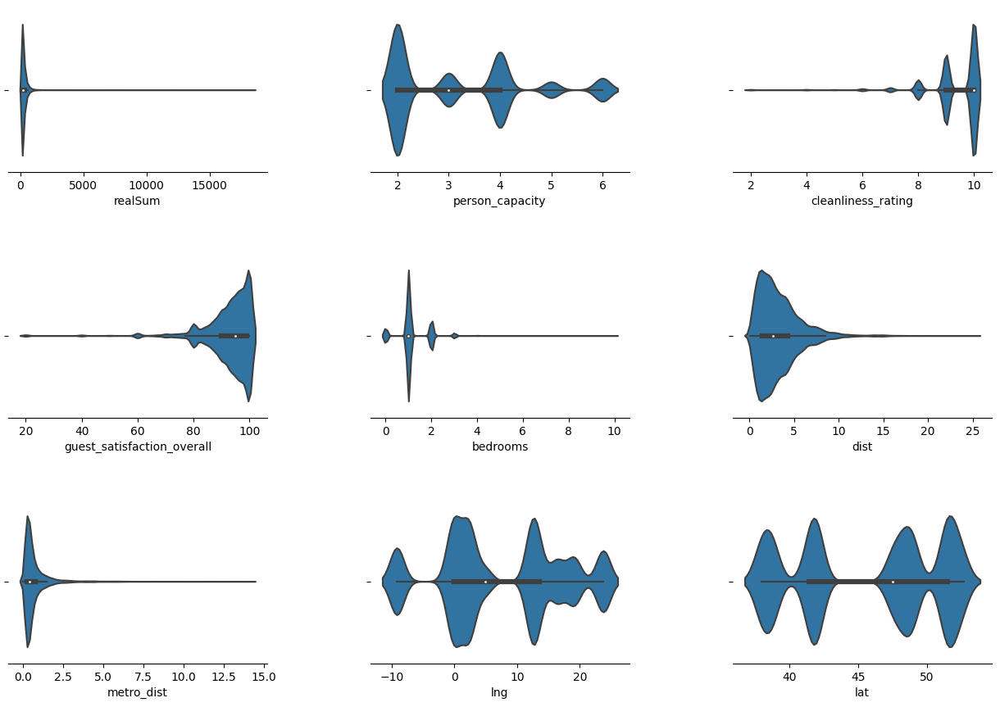

In [21]:
m=math.ceil(math.sqrt(len(nume)))
n=math.ceil(len(nume)/m)

fig, axes = plt.subplots(m,n,figsize=(15,10))
plt.subplots_adjust(left=0.1,
                    bottom=0.1, 
                    right=0.9, 
                    top=0.9, 
                    wspace=0.4, 
                    hspace=0.5)
sns.despine(left=True)
for i in range(m):
    for j in range(n):
        sns.violinplot(ax=axes[i,j], data=air, x=nume[i*n+j])
        
        if i*n+j==len(nume)-1:
            break

In [22]:
x=air.isnull().any().sum()
print('columns with null values:',x)

columns with null values: 0


In [23]:
for col in cate:
    print('-'*40)
    print(f'The column name is: {col}')
    print(air[col].value_counts())

----------------------------------------
The column name is: room_type
Entire home/apt    32648
Private room       18693
Shared room          366
Name: room_type, dtype: int64
----------------------------------------
The column name is: room_shared
False    51341
True       366
Name: room_shared, dtype: int64
----------------------------------------
The column name is: room_private
False    33014
True     18693
Name: room_private, dtype: int64
----------------------------------------
The column name is: host_is_superhost
False    38475
True     13232
Name: host_is_superhost, dtype: int64
----------------------------------------
The column name is: city
london       9993
rome         9027
paris        6688
lisbon       5763
athens       5280
budapest     4022
vienna       3537
barcelona    2833
berlin       2484
amsterdam    2080
Name: city, dtype: int64
----------------------------------------
The column name is: type
weekends    26207
weekdays    25500
Name: type, dtype: int64
-------

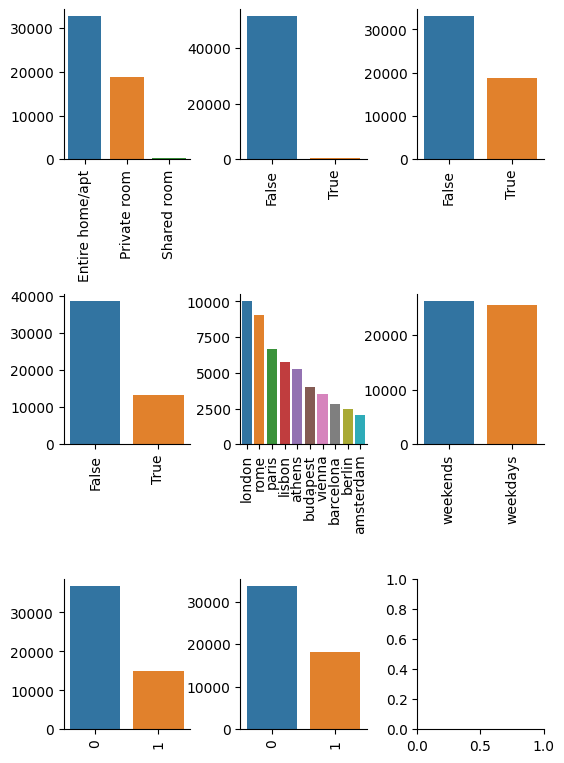

In [24]:
m=math.ceil(math.sqrt(len(cate)))
n=math.ceil(len(cate)/m)
fig, axes = plt.subplots(m,n,figsize=(6,9))
plt.subplots_adjust(left=0.1,
                    bottom=0.1, 
                    right=0.9, 
                    top=0.9, 
                    wspace=0.4, 
                    hspace=0.9)

sns.despine()
for i in range(m):
    for j in range(n):
        sns.barplot(x= air[cate[i*n+j]].value_counts().index,
                    y= air[cate[i*n+j]].value_counts().values,
                   ax=axes[i,j])
        axes[i,j].tick_params(axis='x', labelrotation=90)
        
        if i*n+j==len(cate)-1:
            break


In [25]:
import plotly_express as px

correl = air[nume].corr()
# plt.figure(figsize= (10,10))
fig = px.imshow(correl, zmin = -1, zmax = 1, text_auto = '.2f', color_continuous_scale = ['#DD0000','#FFFFFF','#0000DD'])
fig.update_layout(title = "Correlation")
fig.show()

In [26]:
m = pd.DataFrame()
for city in air.city.unique():
    file = (air[air.city == city][nume].corrwith(air[air.city == city]['realSum']))
    m = pd.concat([m,file], axis = 1)
m.columns = air.city.unique()
fig = px.imshow(m[1:], zmin = -.6, zmax = .6, text_auto = '.2f', color_continuous_scale = ['#DD0000','#FFFFFF','#0000DD'])
fig.update_layout(title = "Correlation with Price by Cities")
fig.show()

In [27]:
# for i in air.city.unique():
fig = px.box(air[(air['realSum'] < np.quantile(air['realSum'], 0.95, axis=0))], y="realSum", color="city", facet_row = 'type', hover_data={"realSum":":.0f"}, color_discrete_sequence=px.colors.qualitative.D3)
# fi.
fig.show()

In [28]:
air['cleanliness_jitter'] = air['cleanliness_rating'] +  np.random.uniform(-.1, .1, size=len(air['cleanliness_rating']))
fig = px.scatter(air, x= 'cleanliness_jitter', y = 'realSum', color = 'city')
fig.update_layout(title = "Price and Cleanliness")
fig.show()

In [29]:
fig = px.scatter(air, x= 'guest_satisfaction_overall', y = 'realSum', color = 'city')
fig.update_layout(title = "Price and Satisfaction")
fig.show()

In [30]:
fig = px.scatter(air, x= 'cleanliness_jitter', y = 'guest_satisfaction_overall', color = 'city')
fig.update_layout(title = "Cleanliness and Satisfaction")
fig.show()

In [31]:
fig = px.scatter(air, x= 'metro_dist', y = 'realSum', color = 'city')
fig.update_layout(title = "Metro Distance and Price")
fig.show()

In [32]:
fig = px.scatter(air, x= 'dist', y = 'realSum', color = 'city')
fig.update_layout(title = "Distance and Price")
fig.show()

In [33]:


def listing_density(city,cityName):
    fig = px.density_mapbox(city, lat = 'lat', lon = 'lng',
                       z = 'realSum',radius = 20,
                       center = dict(lat = city.lat.mean(),
                                    lon = city.lng.mean()),
                       zoom = 10,
                       mapbox_style = 'open-street-map',
                       height = 600)
    fig.update_layout(title=cityName)
    fig.show()

listing_density(amsterdam,'Amsterdam')


In [34]:
listing_density(athens,'Athens')


In [35]:
listing_density(barcelona,'Barcelona')


In [36]:
listing_density(berlin,'Berlin')

In [37]:
listing_density(budapest,'Budapest')

In [38]:
listing_density(lisbon,'Lisbon')

In [39]:
listing_density(london,'London')

In [40]:
listing_density(paris,'Paris')

In [41]:
listing_density(rome,'Rome')

In [42]:
listing_density(vienna,'Vienna')